# Topic 34: Clustering

**_Clustering_** techniques are among the most popular unsupervised machine learning algorithms. The main idea behind clustering is that you want to group objects into similar classes, in a way that:

* intra-class similarity is high
* inter-class similarity is low

> - What does _similarity_ mean? 
    - You should be thinking of it in terms of *distance*, just like we did with the K-Nearest Neighbors algorithm. 
    

<img src="https://raw.githubusercontent.com/jirvingphd/dsc-k-means-clustering-online-ds-sp-000/master/images/k_means.gif">


> There are
**hierarchical** and **nonhierarchical** clustering algorithms:
- **Hierarchical:**
    -  **_agglomerative hierarchical_**:
        - algorithm starts with _n_ clusters (where _n_ is the number of observations, so each observation is a cluster),
        - then combines the two most similar clusters, combines the next two most similar clusters, and so on.         
    - A **_divisive_** hierarchical algorithm does the exact opposite, going from 1 to _n_ clusters.

> **_Nonhierarchical_** algorithms chooses _k_ initial clusters and reassigns observations until no improvement can be obtained. 
- How initial clusters and reassignments are done depends on the specific type of algorithm.



**Today we will be applying K-Means clustering, a non-hierarchical clustering algorithm**


## K-Means Clustering Overview

#### Type of Learning
- Unsupervised

#### Assumptions
- Clusters are spherical
- Clusters are of similar size

#### Advantages
- Fast training


#### Disadvantages
- Need to determine k (# of clusters)
- Sensitive to initial points and local optima"

#### Requirements 
- Features scaled.
- Sensitive to missing data
- Sensitive to outliers.

#### Example Use:
- Segmentation

- Customer segmentation
- Outlier detection"


#### Metrics:
- [Calinski Harabasz Score](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.calinski_harabasz_score.html)
    - Ratio of within-cluster dispersion to between-cluster dispersion

- [Silhouette Score](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html#sklearn.metrics.silhouette_score)
    - The Silhouette Coefficient for a sample is $(b - a) / max(a, b)$. To clarify, b is the distance between a sample and the nearest cluster that the sample is not a part of. Note that Silhouette Coefficient is only defined if number of labels is 2 <= n_labels <= n_samples - 1.

# NHANES Activity Continued:

> Preprocessing from Topic 33

In [2]:
import plotly.express as px
from ipywidgets import interact

In [3]:
## Lets make a preprocessing pipeline with SimpleImputer and StandardScaler

import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
import plotly.express as px
from ipywidgets import interact

from sklearn.preprocessing import StandardScaler,LabelEncoder,OneHotEncoder,MinMaxScaler
from sklearn.impute import SimpleImputer,MissingIndicator
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

from sklearn.model_selection import train_test_split
np.random.seed(123)

pd.set_option('display.max_columns',0)
pd.set_option('display.max_info_rows',200)
plt.style.use('seaborn-notebook')

In [4]:
import os, sys,glob

## Study Group Notebook Folderpath
folder = '../topic_33_pca/national-health-and-nutrition-examination-survey/'
os.listdir(folder)

## Use glob to get list of csvs
files = glob.glob(folder+'*.csv')
files

['../topic_33_pca/national-health-and-nutrition-examination-survey/medications.csv',
 '../topic_33_pca/national-health-and-nutrition-examination-survey/diet.csv',
 '../topic_33_pca/national-health-and-nutrition-examination-survey/examination.csv',
 '../topic_33_pca/national-health-and-nutrition-examination-survey/demographic.csv',
 '../topic_33_pca/national-health-and-nutrition-examination-survey/labs.csv',
 '../topic_33_pca/national-health-and-nutrition-examination-survey/questionnaire.csv']

In [5]:
df = pd.concat([pd.read_csv(file,index_col='SEQN') for file in files[1:]],axis=1)

In [6]:
# Some columns are mostly null data - let's explore
nulls = df.isna().sum() / len(df)
high_null_cols = nulls[nulls>0.99].index.to_list()
num_cols = df.drop(columns=high_null_cols).select_dtypes('number').columns
cat_cols = df.drop(columns=high_null_cols).select_dtypes('object').columns


In [7]:
from sklearn import set_config
set_config(display='diagram')

# Let's discuss - what steps am I doing? Why?
num_transformer = Pipeline(steps=[
    ('num_imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

ohe_transformer = Pipeline(steps=[
    ('cat_imputer', SimpleImputer(strategy='constant', fill_value='MISSING')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))])

high_nulls_transformer = Pipeline(steps=[
    ('null_indicator', MissingIndicator())])


preprocessor = ColumnTransformer(
    transformers=[
        ('num', num_transformer, num_cols),
        ('cat_ohe', ohe_transformer, cat_cols), 
        ('cat_null', high_nulls_transformer, high_null_cols)])


preprocessor

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('num_imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', StandardScaler())]),
                                 Index(['WTDRD1', 'WTDR2D', 'DR1DRSTZ', 'DR1EXMER', 'DRABF', 'DRDINT',
       'DR1DBIH', 'DR1DAY', 'DR1LANG', 'DR1MNRSP',
       ...
       'WHD080S', 'WHD080T', 'WHD110', 'WHD120', 'WHD130', 'WHD140', 'WHQ150',
       'WHQ030M', 'WHQ500', 'WHQ520'],
      dtype='object',...
                                 Pipeline(steps=[('null_indicator',
                                                  MissingIndicator())]),
                                 ['DRQSDT4', 'DRQSDT5', 'DRQSDT6', 'DRQSDT8',
                                  'DRQSDT9', 'DRQSDT10', 'DRQSDT11', 'DRQSDT12',
                                  'DRQSDT91', 'DRD350JQ', 'DRD370HQ',
                                  'DRD370JQ', 'DRD370LQ', 'DRD370OQ',
                                  'DRD370PQ', 'DRD370QQ', 'DRD370SQ',
                                  'BMIRECUM', 'BMIHEAD', 'CSQ260D', 'PHAALCHR',
                                  'PHAALCMN', 'PHAANTHR', 'PHAANTMN',
                                  'PHASUPHR', 'PHASUPMN', 'LBXHCG', 'LBXEMA',
                                  'URXVOL3', 'URDFLOW3', ...])])

In [8]:
### TTS NOT NEEDED FOR UNSUPERVISED LEARNING
# ## Train Test Split the data and preprocess
# df_train,df_test= train_test_split(df,random_state=321)

# train_data = preprocessor.fit_transform(df_train)
# test_data = preprocessor.transform(df_test)

In [9]:
## Get column names to make X-train, X_test for later
data = preprocessor.fit_transform(df)
encoder = preprocessor.named_transformers_['cat_ohe'].named_steps['encoder']
processed_columns = [*num_cols,*encoder.get_feature_names(cat_cols),*high_null_cols ]

data_df = pd.DataFrame(data, columns =processed_columns,index=df.index)
data_df

,WTDRD1,WTDR2D,DR1DRSTZ,DR1EXMER,DRABF,DRDINT,DR1DBIH,DR1DAY,DR1LANG,DR1MNRSP,DR1HELPD,DBQ095Z,DBD100,DRQSPREP,DR1STY,DR1SKY,DRQSDIET,DRQSDT1,DRQSDT2,DRQSDT3,DRQSDT7,DR1TNUMF,DR1TKCAL,DR1TPROT,DR1TCARB,DR1TSUGR,DR1TFIBE,DR1TTFAT,DR1TSFAT,DR1TMFAT,DR1TPFAT,DR1TCHOL,DR1TATOC,DR1TATOA,DR1TRET,DR1TVARA,DR1TACAR,DR1TBCAR,DR1TCRYP,DR1TLYCO,...,RHQ542B,RHQ542D,RHQ576Q,RHQ576U,RHQ580,RHQ586Q,RHQ586U,RHQ596,RHQ602Q,RHQ602U,RXQ525Q,RXQ525U,SMD630,SMQ661,SMQ665A,SMQ665B,SMQ665C,SMQ665D,SMQ690B,SMQ740,SMQ690G,SMQ845,SMQ690D,SMQ800,SMQ690E,SMQ817,SMQ690I,SMQ857,SMQ690J,SMQ861,SMQ690F,SMQ830,SMQ840,SXQ550,SXQ841,WHD080I,WHD080K,WHD080P,WHD080U,WHD080L
SEQN,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
73557,-0.405289,-0.427634,-0.366909,0.234545,0.115522,0.345844,-0.929668,-1.261798,-0.260165,-0.221771,0.355429,-0.020877,0.968468,0.768756,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-0.762900,-0.401714,-0.719191,-0.000058,1.033476,-0.443095,-0.499045,-0.436419,-0.437780,-0.700310,-0.195746,-0.614115,-0.222951,-0.958302,-0.944236,-0.240513,-0.365319,0.653313,-0.344054,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0
73558,-0.375876,-0.432828,-0.366909,0.756411,0.115522,0.345844,-1.112842,-1.752841,-0.260165,-0.221771,0.355429,-0.205833,0.968468,-0.140261,-1.371492,-0.043233,0.123882,0.0,0.0,0.0,0.0,-1.315012,3.458453,6.451903,1.619615,-0.917636,0.190491,1.211351,2.000972,0.660767,0.310606,10.831050,1.992310,-0.222951,3.003553,1.861199,-0.303222,-0.409453,-0.193296,-0.536466,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
73559,0.799463,0.129454,-0.366909,0.234545,0.115522,0.345844,0.169375,0.702372,-0.260165,-0.221771,0.355429,-0.205833,-0.513361,-1.049278,0.151806,-0.043233,-1.648978,0.0,0.0,0.0,0.0,2.181696,-0.214682,-0.208327,-0.133719,-0.058274,-0.539744,-0.184149,0.073399,-0.281999,-0.343251,-0.757532,0.143923,-0.222951,0.579135,0.165316,-0.281274,-0.325071,-0.120093,-0.465584,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
73560,3.125961,1.951912,-0.366909,0.495478,0.115522,0.345844,0.444136,-0.770756,-0.260165,-0.221771,0.090232,-0.205833,-0.513361,-0.140261,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,0.709398,-0.494677,0.111633,-0.674255,-0.389494,-0.464573,-0.368397,-0.046590,-0.535232,-0.632085,-0.297889,-0.883640,-0.222951,0.294737,-0.058631,-0.282319,-0.383916,0.478262,-0.536466,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
73561,0.782853,0.121258,-0.366909,0.965157,0.115522,0.345844,0.169375,-1.752841,-0.260165,-0.221771,0.355429,0.071601,-0.513361,0.768756,0.151806,-0.043233,-1.648978,0.0,0.0,0.0,0.0,-1.499049,-0.571039,-0.436487,-0.539891,-0.282649,-0.282014,-0.438028,-1.350039,0.061636,-1.355380,-0.975746,6.927977,-0.222951,0.922664,0.588777,-0.303222,-0.040006,-0.231488,-0.536466,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83727,-0.482544,-0.478380,-0.366909,0.756411,0.115522,0.345844,-0.746494,1.193414,-0.260165,-0.221771,0.355429,-0.205833,-0.513361,-0.140261,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,1.629584,3.043441,3.656272,2.241842,0.798417,1.661701,2.867670,3.850537,2.113297,1.184639,2.5

In [10]:
def get_pca(data_df,n_components=6,preprocessor=None):
    
    ## If no preprocessor, use following pipelines
    if preprocessor is None:
        num_transformer = Pipeline(steps=[
        ('num_imputer', SimpleImputer(strategy='median')),
        ('scaler', StandardScaler())])
        ohe_transformer = Pipeline(steps=[
            ('cat_imputer', SimpleImputer(strategy='constant', fill_value='MISSING')),
            ('ohe', OneHotEncoder(handle_unknown='ignore'))])

        high_nulls_transformer = Pipeline(steps=[
            ('null_indicator', MissingIndicator())])

        preprocessor = ColumnTransformer(
            transformers=[
                ('num', num_transformer, num_cols),
                ('cat_ohe', ohe_transformer, cat_cols), 
                ('cat_null', high_nulls_transformer, high_null_cols)])
        
    ## Make pca_pipe
    pca_pipe = Pipeline([
        ('prep',preprocessor),
        ('pca',PCA(n_components=n_components))
            ])
    
    ## fit_transform and make a df
    feature_names = [f"PC{n}" for n in range(1,n_components+1)]
    data_pca = pd.DataFrame(pca_pipe.fit_transform(data_df),
                                 columns=feature_names,
                                 index=data_df.index) 
    
    return data_pca
    


In [11]:
## Get PCs for train and test
df_pca = get_pca(df, 6,preprocessor)
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6
SEQN,,,,,,
73557,8.468984,-2.562522,-10.179218,3.722359,1.353368,2.283805
73558,10.257366,-7.224932,9.156071,-9.495873,14.587641,2.050699
73559,5.944623,-3.134162,-1.217816,0.307433,-1.533205,-4.073905
73560,-7.671590,1.182393,-0.463759,0.213264,1.418316,-0.869592
73561,7.320566,-2.565094,-9.601853,3.046575,2.933793,-2.959591
...,...,...,...,...,...,...
83727,3.250349,-4.849327,12.805920,-6.556900,8.241832,1.392728
83728,-10.121872,2.572718,-3.032330,1.689652,4.155455,-3.870641
83729,3.115179,-2.585870,3.009745,-2.103818,0.791740,-3.890762


## Visualizing our PC's

In [12]:
def plot_pca_3D(df_pca,x='PC1',y='PC2',z='PC3',color=None):
    ## Make figure and update markers
    fig  = px.scatter_3d(df_pca, x=x, y=y, z=z,color=color,
                         template='plotly_dark')
    fig.update_traces(marker={'size':2})
    
    ## Set config and show 
    config = dict({'scrollZoom': False})
    fig.show(config=config)
    
plot_pca_3D(df_pca)#,'PC1','PC2','PC3')

In [13]:
## Make interactive
feature_names = df_pca.columns
@interact(x=feature_names,y=feature_names,z=feature_names)
def interact_3D_pca(x='PC1',y='PC2',z='PC3'):
    plot_pca_3D(df_pca,x=x,y=y,z=z)

interactive(children=(Dropdown(description='x', options=('PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6'), value='PC1…

## Use K-Means Clustering to Identify Groups of People

In [14]:
from sklearn.cluster import KMeans
from sklearn import metrics

In [15]:
## Create a K-Means model with n_clusters=2
kmeans = KMeans(n_clusters=2)
kmeans.fit(df_pca)

KMeans(n_clusters=2)

In [16]:
## Get Predictions (clusters) for train and tes
clusters = pd.Series(kmeans.predict(df_pca),index=df_pca.index)
clusters.value_counts(1)

1    0.967273
0    0.032727
dtype: float64

In [17]:
## Print Calinski Harabasz score
score = metrics.calinski_harabasz_score(df_pca,clusters)
print(f"Calinski-Harabasz Score = {score:.2f}")

## Print Model Intertia
print(f"KMeans' Inertia = {kmeans.inertia_:.2f}")

Calinski-Harabasz Score = 2950.89
KMeans' Inertia = 1445050.93


In [18]:
## Make a new plot_df from df_pca and save the clusters as a column
plot_df = df_pca.copy()
plot_df['cluster'] = clusters

## Convert cluster col to str for plotlty
plot_df['cluster'] = plot_df['cluster'].astype(str)
display(plot_df['cluster'].value_counts(1))

plot_df.head()

1    0.967273
0    0.032727
Name: cluster, dtype: float64

,PC1,PC2,PC3,PC4,PC5,PC6,cluster
SEQN,,,,,,,
73557,8.468984,-2.562522,-10.179218,3.722359,1.353368,2.283805,1
73558,10.257366,-7.224932,9.156071,-9.495873,14.587641,2.050699,1
73559,5.944623,-3.134162,-1.217816,0.307433,-1.533205,-4.073905,1
73560,-7.671590,1.182393,-0.463759,0.213264,1.418316,-0.869592,1
73561,7.320566,-2.565094,-9.601853,3.046575,2.933793,-2.959591,1


In [19]:
def get_kmeans(df_pca,n_clusters=2,verbose=False):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(df_pca)
    
    ## Get Predictions (clusters) for train and tes
    clusters = pd.Series(kmeans.predict(df_pca),index=df_pca.index)
    
    ## Copy df as plto_df and add clsuter column
    plot_df = df_pca.copy()
    plot_df['cluster'] = clusters

    ## Convert cluster col to str for plotlty
    plot_df['cluster'] = plot_df['cluster'].astype(str)
    
    if verbose: 
        display(plot_df['cluster'].value_counts(1))
    
    return plot_df

In [20]:
## Test function for n_clusters = 3
plot_df = get_kmeans(df_pca,3,verbose=True)

2    0.559214
0    0.408059
1    0.032727
Name: cluster, dtype: float64

In [21]:
## Use our functions to make an interactive 
feature_names = plot_df.drop(columns='cluster').columns
@interact(x=feature_names,y=feature_names,z=feature_names)
def plot_pca_with_clusters(x='PC1',y='PC2',z='PC3'):
    plot_pca_3D(plot_df,x,y,z,color='cluster')


interactive(children=(Dropdown(description='x', options=('PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6'), value='PC1…

## Visualize Different Clusters for Different Values for K

> Create a new big interactive function below:
- Combine:
    - K-Means modeling (with any k value)
    - plot_3d_pca  with a slider for k
    

In [22]:
## PASTE OUR INTERACT PLOT AND UPDATE TO SHOW CLUSTERS
## PLot
feature_names = plot_df.drop(columns=['cluster']).columns

@interact(x=feature_names,y=feature_names,z=feature_names, k=(0,20))
def test_different_ks(x='PC1',y='PC2',z='PC3',k=2):
    plot_df = get_kmeans(df_pca,n_clusters=k,verbose=False)
    plot_pca_3D(plot_df,x,y,z,color='cluster')
  

interactive(children=(Dropdown(description='x', options=('PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6'), value='PC1…

# Finding the Best Value for K

## Elbow Plots

<img src="https://raw.githubusercontent.com/jirvingphd/dsc-k-means-clustering-online-ds-pt-100719/master/images/new_dim_returns.png" width=60%>

In [23]:
## Find best K (try 2-29), save intertia and cal har score
ks = range(2,30)
cal_haz_scores = []
inertia = []

for k in ks:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_pca)
    clusters = kmeans.predict(df_pca)
    
    score = metrics.calinski_harabasz_score(df_pca,clusters)
    cal_haz_scores.append(score)
    
    inertia.append(kmeans.inertia_)

In [24]:
## Turn results into dataframe with ks as the index
res_df = pd.DataFrame({'K':ks,
                      'calinski harabasz score':cal_haz_scores,
                      'intertia':inertia})
res_df.set_index('K',inplace=True)
res_df

,calinski harabasz score,intertia
K,,
2,2950.893435,1.445051e+06
3,3737.040748,1.074626e+06
4,4445.703411,8.065815e+05
5,5136.722562,6.172231e+05
6,5555.738662,4.995655e+05
7,5914.144577,4.152083e+05
8,5618.494867,3.829303e+05
9,5436.767158,3.531826e+05
10,5309.781099,3.269873e+05


array([<AxesSubplot:xlabel='K'>, <AxesSubplot:xlabel='K'>], dtype=object)

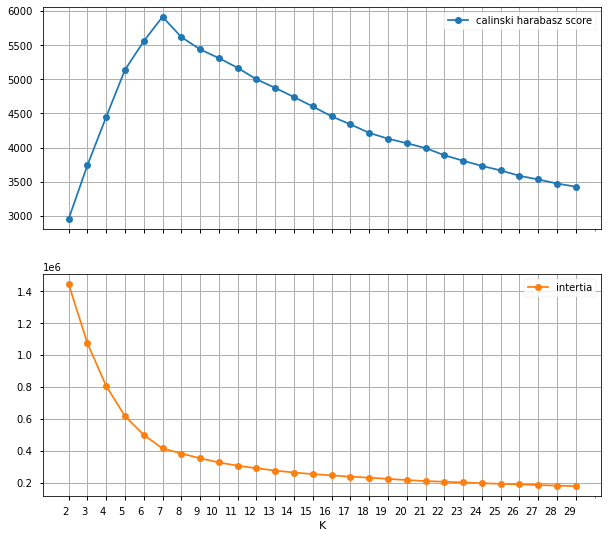

In [25]:
## Use DataFrame to PLot Metrics
# We want: subplots,lines+markers, a grid, xticks for each k
res_df.plot(subplots=True, marker='o',figsize=(10,10),rot=0,grid=True,xticks=res_df.index)

### Q: What value for K do we think is best?

In [26]:
## Best K
best_k = 7

In [28]:
## Fit model and get preds, use random_state=42 to match  visuals
kmeans = KMeans(best_k,random_state=42)
kmeans.fit(df_pca)
clusters = pd.Series(kmeans.predict(df_pca), index=df_pca.index)
clusters.value_counts(1)

2    0.279115
0    0.269779
5    0.179459
6    0.120098
4    0.108305
1    0.032334
3    0.010909
dtype: float64

## Modeling to Predict & Explain Our Clusters 

- We will use our clusters identified above as the target in a new model using the ORIGINAL data (not-pca)
- We will examine feature importance to determine what features may explain the PCs we used to identify the clusters. 

In [29]:
clusters

SEQN
73557    6
73558    4
73559    0
73560    2
73561    6
        ..
83727    4
83728    2
83729    0
83730    2
83731    2
Length: 10175, dtype: int32

In [32]:
X = data_df.copy()
y = clusters.copy()

X_train, X_test, y_train, y_test = train_test_split(X,y)

In [37]:
def evaluate_model(model,X_test,y_test,classes=None,
                           normalize='true',cmap='Purples',label='',
                   return_report=False,
                   top_n=20, tree=False,return_important = False, ):
    """Accepts an sklearn-compatible classification model + test data 
    and displays several sklearn.metrics functions: 
    - classifciation_report
    - plot_confusion_matrix
    - plot_roc_curve
    """
     
    ## Get Predictions
    y_hat_test = model.predict(X_test)
    
    
    ## Classification Report / Scores 
    table_header = "[i] CLASSIFICATION REPORT"
    
    ## Add Label if given
    if len(label)>0:
        table_header += f" {label}"
        
    
    ## PRINT CLASSIFICATION REPORT
    dashes = '---'*20
    print(dashes,table_header,dashes,sep='\n')

    print(metrics.classification_report(y_test,y_hat_test,
                                    target_names=classes))
    
    report = metrics.classification_report(y_test,y_hat_test,
                                               target_names=classes,
                                          output_dict=True)
    print(dashes+"\n\n")
    
    

    ## MAKE FIGURE
    fig, axes = plt.subplots(figsize=(10,4),ncols=2)
    
    ## Plot Confusion Matrix 
    metrics.plot_confusion_matrix(model, X_test,y_test,
                                  display_labels=classes,
                                  normalize=normalize,
                                 cmap=cmap,ax=axes[0])
    axes[0].set(title='Confusion Matrix')
    
    try:
        ## Plot Roc Curve
        roc_plot = metrics.plot_roc_curve(model, X_test, y_test,ax=axes[1])
        axes[1].legend()
        axes[1].plot([0,1],[0,1],ls=':')
        axes[1].grid()
        axes[1].set_title('Receiving Operator Characteristic (ROC) Curve') 
        fig.tight_layout()
    except:
        fig.delaxes(axes[1])
        pass
    plt.show()

    
    
    ## Importance 
    if tree: 
        fig2,ax2 = plt.subplots()
        important = pd.Series(model.feature_importances_,index=X_test.columns).sort_values(ascending=False)
        important.sort_values().tail(top_n).plot(kind='barh',ax=ax2)
        important = important.sort_values(ascending=False)
        plt.show()

    if return_important & return_report:
        raise Exception('Only one of return_important or return_report may be True')
    if return_report:
        return report #fig,axes
    if return_important:
        return important

In [35]:
from sklearn.ensemble import RandomForestClassifier

## fit a random forest criterion='entropy',max_features=100,random_state=123)
clf = RandomForestClassifier(criterion='entropy',max_features=100,random_state=123)
clf.fit(X_train,y_train)

RandomForestClassifier(criterion='entropy', max_features=100, random_state=123)

------------------------------------------------------------
[i] CLASSIFICATION REPORT
------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.82      0.96      0.88       705
           1       1.00      1.00      1.00        75
           2       0.99      0.99      0.99       712
           3       1.00      1.00      1.00        29
           4       0.92      0.81      0.86       285
           5       0.94      0.83      0.88       450
           6       0.92      0.81      0.86       288

    accuracy                           0.91      2544
   macro avg       0.94      0.91      0.93      2544
weighted avg       0.92      0.91      0.91      2544

------------------------------------------------------------




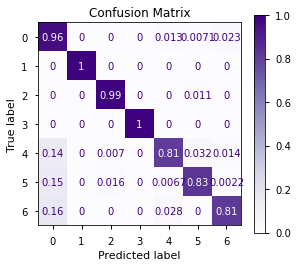

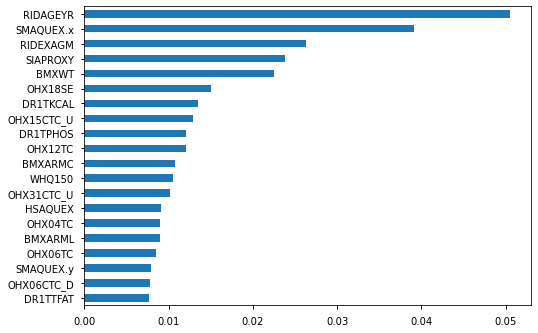

In [38]:
## evsluate model
importance = evaluate_model(clf,X_test,y_test,tree=True,return_important=True)

In [39]:
## save top 30 most important
most_important = importance.head(30)
most_important

RIDAGEYR           0.050480
SMAQUEX.x          0.039118
RIDEXAGM           0.026297
SIAPROXY           0.023759
BMXWT              0.022489
OHX18SE            0.015056
DR1TKCAL           0.013495
OHX15CTC_U         0.012844
DR1TPHOS           0.012077
OHX12TC            0.012047
BMXARMC            0.010737
WHQ150             0.010459
OHX31CTC_U         0.010177
HSAQUEX            0.009096
OHX04TC            0.008935
BMXARML            0.008916
OHX06TC            0.008482
SMAQUEX.y          0.007843
OHX06CTC_D         0.007802
DR1TTFAT           0.007674
SMAQUEX2           0.007655
OHX02SE            0.007411
OHX11TC            0.007211
CSXTSEQ_MISSING    0.007061
OHX06CTC_S         0.006897
OHX22CTC_S         0.006793
OHX11CTC_S         0.006697
OHX15SE            0.006666
DR1TSFAT           0.006426
OHX27CTC_S         0.006044
dtype: float64

In [40]:
## Get top_feature names NOT ohe-names
top_features = []
for col in most_important.index:
    top_features.append(col.split('_')[0])
    
top_features = list(set(top_features))
top_features

['OHX06CTC',
 'OHX11TC',
 'RIDAGEYR',
 'SMAQUEX2',
 'DR1TTFAT',
 'BMXARMC',
 'CSXTSEQ',
 'SMAQUEX.y',
 'HSAQUEX',
 'OHX31CTC',
 'BMXARML',
 'OHX15CTC',
 'SIAPROXY',
 'OHX06TC',
 'OHX02SE',
 'OHX22CTC',
 'DR1TSFAT',
 'SMAQUEX.x',
 'OHX27CTC',
 'OHX04TC',
 'RIDEXAGM',
 'WHQ150',
 'BMXWT',
 'DR1TPHOS',
 'OHX11CTC',
 'OHX18SE',
 'OHX12TC',
 'OHX15SE',
 'DR1TKCAL']

## NHANES VARIABLE SEARCH

https://wwwn.cdc.gov/nchs/nhanes/Search/default.aspx

In [43]:
# Search 2013-2014 dataset for variable meanings https://wwwn.cdc.gov/nchs/nhanes/Search/default.aspx
col_dict = {'LBDWFL':'Fluoride, water (mg/L) average 2 values' , 
            'BMXWT': 'Weight (kg)',
            'RIDAGEYR':'Age in years at screening',
             'LBXSCR': 'Creatinine (mg/dL)' ,
             'LBXSGTSI':'Gamma glutamyl transferase (U/L)' ,
             'BMXARML': 'Upper Arm Length (cm)',
             'BPXSY2': 'Systolic: Blood pres (2nd rdg) mm Hg',
             'CSXTSEQ': 'Whole Mouth Taste Test Sequence',
            'LBDSCRSI':'Creatinine (umol/L)',
            'LBXSATSI': 'Alanine aminotransferase ALT (IU/L)',
            'BMXARMC': 'Arm Circumference (cm)',
            'MGDCGSZ': 'Combined grip strength (kg)',
            'BMXSAD1':'Sagittal Abdominal Diameter 1st (cm)' ,
            'LBXSTR': 'Triglycerides, refrigerated (mg/dL)',
            'PFQ061D':'Stooping, crouching, kneeling difficulty',
            'LBDSTRSI': 'Triglycerides, refrigerated (mmol/L)',
            'MGXH2T2': 'Grip strength (kg), hand 2, test 2',
            'OHX06CTC': 'Coronal Caries: Tooth Count #6',
            'DR1TMOIS': 'Moisture (gm)',
            'BMXWAIST': 'Waist Circumference (cm)',
            'ORXH83':'HPV Type 83' ,
            'OHX04TC':'Tooth Count: #4',
           'PFQ061M':'Standing for long periods difficulty',
           'PFQ061T':'Push or pull large objects difficulty',
           'OHX12TC': 'Tooth Count: #12',
           'PFQ051':'Limited in amount of work you can do',
           'RIDEXAGM':'Age in months at exam - 0 to 19 years',
           'PEASCTM1':'Blood Pressure Time in Seconds',
           'ORXH61':'HPV Type 61',
           'OHX05TC':'Tooth Count: #5',
           'CDQ010':'Shortness of breath on stairs/inclines',
           'OHX27CTC':'Coronal Caries: Tooth Count #27',
           'OHX22CTC':'Coronal Caries: Tooth Count #22',
} 

new_keys = {'OHX11CTC': 'Coronal Caries: Tooth Count #11',
            'OHX21CTC':'Coronal Caries: Tooth Count #21' ,
            'OHX10CTC': 'Coronal Caries: Tooth Count #10',
            'OHX13CTC': 'Coronal Caries: Tooth Count #13',
            'OHX28CTC': 'Coronal Caries: Tooth Count #28',
            'OHX29CTC': 'Coronal Caries: Tooth Count #29',
            'BMXHT':'Standing Height (cm)',
            'PFQ061F': 'House chore difficulty',
            'OHX23CTC': 'Coronal Caries: Tooth Count #23',
            'SMQ856': 'Last 7-d worked at job not at home?',
            'OHX12CTC': 'Coronal Caries: Tooth Count #12',
            'OHX20CTC': 'Coronal Caries: Tooth Count #20',
            'DLQ050': 'Have serious difficulty walking ?',
            'PFQ049': 'Limitations keeping you from working',
            'PFQ061E': 'Lifting or carrying difficulty',
            'ORXH40': 'HPV Type 40',
            'WHQ150': 'Age when heaviest weight',
            'ORXH73': 'HPV Type 73',
            'ORXH35': 'HPV Type 35', 
            'PFQ063A': 'Health problems causing difficulty',
            'OHX04CTC':'Coronal Caries: Tooth Count #4',
           'MGXH2T3':'Grip strength (kg), hand 2, test 3'}

col_dict.update(new_keys)

In [44]:
missing_features = []
for feature in top_features:
    if feature in col_dict:
        print(f"Found {feature} in col_dict")
    else:
        missing_features.append(feature)

missing_features

Found OHX06CTC in col_dict
Found RIDAGEYR in col_dict
Found BMXARMC in col_dict
Found CSXTSEQ in col_dict
Found BMXARML in col_dict
Found OHX22CTC in col_dict
Found OHX27CTC in col_dict
Found OHX04TC in col_dict
Found RIDEXAGM in col_dict
Found WHQ150 in col_dict
Found BMXWT in col_dict
Found OHX11CTC in col_dict
Found OHX12TC in col_dict


['OHX11TC',
 'SMAQUEX2',
 'DR1TTFAT',
 'SMAQUEX.y',
 'HSAQUEX',
 'OHX31CTC',
 'OHX15CTC',
 'SIAPROXY',
 'OHX06TC',
 'OHX02SE',
 'DR1TSFAT',
 'SMAQUEX.x',
 'DR1TPHOS',
 'OHX18SE',
 'OHX15SE',
 'DR1TKCAL']

In [45]:
# top_features
new_features = {'OHX02CTC':"Coronal Caries: Tooth count #2",
 'OHX18CTC':"",
 'OHX21TC': "",
 'BMXBMI':"Body Mass Index (kg/m**2)",
 'OHX31CTC':"",
 'OHX15CTC':"",
 'OHX05CTC':"",
 'MGXH1T3':"Grip strength (kg), hand 1, test 3",
 'OHX06TC':"",
 'OHX24CTC':"",
 'OHX11TC':"",
 'MGXH1T2':"Grip strength (kg), hand 1, test 2"}
col_dict.update(new_features)
col_dict

{'LBDWFL': 'Fluoride, water (mg/L) average 2 values',
 'BMXWT': 'Weight (kg)',
 'RIDAGEYR': 'Age in years at screening',
 'LBXSCR': 'Creatinine (mg/dL)',
 'LBXSGTSI': 'Gamma glutamyl transferase (U/L)',
 'BMXARML': 'Upper Arm Length (cm)',
 'BPXSY2': 'Systolic: Blood pres (2nd rdg) mm Hg',
 'CSXTSEQ': 'Whole Mouth Taste Test Sequence',
 'LBDSCRSI': 'Creatinine (umol/L)',
 'LBXSATSI': 'Alanine aminotransferase ALT (IU/L)',
 'BMXARMC': 'Arm Circumference (cm)',
 'MGDCGSZ': 'Combined grip strength (kg)',
 'BMXSAD1': 'Sagittal Abdominal Diameter 1st (cm)',
 'LBXSTR': 'Triglycerides, refrigerated (mg/dL)',
 'PFQ061D': 'Stooping, crouching, kneeling difficulty',
 'LBDSTRSI': 'Triglycerides, refrigerated (mmol/L)',
 'MGXH2T2': 'Grip strength (kg), hand 2, test 2',
 'OHX06CTC': 'Coronal Caries: Tooth Count #6',
 'DR1TMOIS': 'Moisture (gm)',
 'BMXWAIST': 'Waist Circumference (cm)',
 'ORXH83': 'HPV Type 83',
 'OHX04TC': 'Tooth Count: #4',
 'PFQ061M': 'Standing for long periods difficulty',
 'PFQ

- LB = Laboratory Measures
- BM = Body Measures

In [46]:
most_important

RIDAGEYR           0.050480
SMAQUEX.x          0.039118
RIDEXAGM           0.026297
SIAPROXY           0.023759
BMXWT              0.022489
OHX18SE            0.015056
DR1TKCAL           0.013495
OHX15CTC_U         0.012844
DR1TPHOS           0.012077
OHX12TC            0.012047
BMXARMC            0.010737
WHQ150             0.010459
OHX31CTC_U         0.010177
HSAQUEX            0.009096
OHX04TC            0.008935
BMXARML            0.008916
OHX06TC            0.008482
SMAQUEX.y          0.007843
OHX06CTC_D         0.007802
DR1TTFAT           0.007674
SMAQUEX2           0.007655
OHX02SE            0.007411
OHX11TC            0.007211
CSXTSEQ_MISSING    0.007061
OHX06CTC_S         0.006897
OHX22CTC_S         0.006793
OHX11CTC_S         0.006697
OHX15SE            0.006666
DR1TSFAT           0.006426
OHX27CTC_S         0.006044
dtype: float64

In [50]:
## Make df of most important features and map details onto var name
df_importance = pd.DataFrame({'variable':most_important.index,'importance':most_important})
df_importance['details'] = df_importance['variable'].map(col_dict)

df_importance = df_importance[['variable','details','importance']].reset_index(drop=True)
df_importance.style.bar('importance')

,variable,details,importance
0,RIDAGEYR,Age in years at screening,0.050480
1,SMAQUEX.x,nan,0.039118
2,RIDEXAGM,Age in months at exam - 0 to 19 years,0.026297
3,SIAPROXY,nan,0.023759
4,BMXWT,Weight (kg),0.022489
5,OHX18SE,nan,0.015056
6,DR1TKCAL,nan,0.013495
7,OHX15CTC_U,nan,0.012844
8,DR1TPHOS,nan,0.012077
9,OHX12TC,Tooth Count: #12,0.012047


In [56]:
plot_df = pd.concat([X_train,X_test])#.copy()
plot_df['cluster'] = pd.concat([y_train,y_test])
plot_df.rename(mapper=col_dict,axis=1,inplace=True)
plot_df.columns

Index(['WTDRD1', 'WTDR2D', 'DR1DRSTZ', 'DR1EXMER', 'DRABF', 'DRDINT',
       'DR1DBIH', 'DR1DAY', 'DR1LANG', 'DR1MNRSP',
       ...
       'SMQ830', 'SMQ840', 'SXQ550', 'SXQ841', 'WHD080I', 'WHD080K', 'WHD080P',
       'WHD080U', 'WHD080L', 'cluster'],
      dtype='object', length=2501)

## Visualize Clusters by Most Important Features

In [57]:
cluster_d = {}

for cluster in plot_df['cluster'].unique():
    cluster_d[cluster] = plot_df.groupby('cluster').get_group(cluster)
cluster_d[0]

,WTDRD1,WTDR2D,DR1DRSTZ,DR1EXMER,DRABF,DRDINT,DR1DBIH,DR1DAY,DR1LANG,DR1MNRSP,DR1HELPD,DBQ095Z,DBD100,DRQSPREP,DR1STY,DR1SKY,DRQSDIET,DRQSDT1,DRQSDT2,DRQSDT3,DRQSDT7,DR1TNUMF,DR1TKCAL,DR1TPROT,DR1TCARB,DR1TSUGR,DR1TFIBE,DR1TTFAT,DR1TSFAT,DR1TMFAT,DR1TPFAT,DR1TCHOL,DR1TATOC,DR1TATOA,DR1TRET,DR1TVARA,DR1TACAR,DR1TBCAR,DR1TCRYP,DR1TLYCO,...,RHQ542D,RHQ576Q,RHQ576U,RHQ580,RHQ586Q,RHQ586U,RHQ596,RHQ602Q,RHQ602U,RXQ525Q,RXQ525U,SMD630,SMQ661,SMQ665A,SMQ665B,SMQ665C,SMQ665D,SMQ690B,SMQ740,SMQ690G,SMQ845,SMQ690D,SMQ800,SMQ690E,SMQ817,SMQ690I,SMQ857,SMQ690J,SMQ861,SMQ690F,SMQ830,SMQ840,SXQ550,SXQ841,WHD080I,WHD080K,WHD080P,WHD080U,WHD080L,cluster
SEQN,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
82577,3.003902,-0.699846,-0.366909,0.234545,0.115522,-2.891475,1.726353,-0.279713,-0.260165,-0.221771,0.355429,0.071601,-0.513361,-1.958295,0.151806,-0.043233,-1.648978,0.0,0.0,0.0,0.0,-0.026751,-0.298791,1.531972,-0.647347,-0.761226,-0.067239,-0.767043,-1.001302,-0.628222,-0.564811,0.124612,-0.277209,-0.222951,-0.068503,-0.331438,-0.303222,-0.373091,0.051775,-0.536466,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0
82920,-0.223829,-0.352483,-0.366909,0.756411,0.115522,0.345844,0.718897,1.193414,-0.260165,-0.221771,0.355429,-0.205833,0.968468,-0.140261,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,0.157286,-0.759178,-0.775927,-0.487569,-0.100567,-0.818952,-0.799107,-0.484292,-0.831596,-0.860225,-0.451103,-0.782568,-0.222951,-0.212110,-0.461734,-0.301131,-0.412506,-0.231488,-0.536328,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0
75921,-0.537711,-0.287211,-0.366909,0.860784,0.115522,0.345844,-1.296016,-0.279713,-0.260165,-0.221771,0.355429,0.071601,-0.513361,-0.140261,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-0.578863,-0.421635,-0.386813,0.064926,0.463041,-0.088716,-0.773982,-0.588803,-0.739771,-0.709921,-0.302532,-0.732032,-0.222951,-0.783721,-0.828191,-0.259326,-0.336452,-0.221940,-0.536466,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0
78203,-0.362705,-0.436041,-0.366909,0.756411,0.115522,0.345844,0.535723,0.702372,-0.260165,-0.221771,0.355429,0.071601,-0.513361,0.768756,0.151806,-0.043233,-1.648978,0.0,0.0,0.0,0.0,1.261510,0.126181,0.046131,0.245280,0.501921,0.222708,0.127637,-0.718107,-0.180668,1.347064,1.800685,0.545147,-0.222951,-0.397954,0.676320,1.040833,1.485804,-0.091448,0.037741,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0
75393,0.984351,0.559088,-0.366909,0.860784,0.115522,0.345844,-0.746494,-0.279713,-0.260165,-0.221771,0.355429,-0.205833,-0.513361,0.768756,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-0.394825,0.194796,-0.342983,-0.123079,0.532491,-1.087421,0.062313,0.047511,0.795014,-0.393988,-0.400032,-0.733563,-0.222951,-1.068119,-1.029742,-0.253055,-0.351718,0.016765,-0.449757,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82181,3.014426,1.222407,-0.366909,-2.218225,0.115522,0.345844,-0.013799,1.193414,-0.260165,-0.221771,0.355429,-0.205833,-0.513361,0.768756,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-0.210788,-0.191442,-0.380725,-0.304137,-0.326277,-0.174626,0.224069,-0.361426,0.671178,0.606453,0.61211

/opt/anaconda3/envs/learn-env-new/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



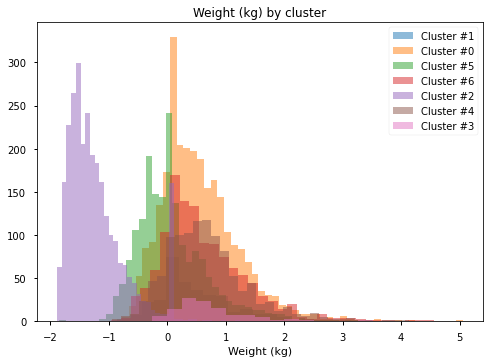

In [60]:
## Plot distribution of weight across clusters
col = 'Weight (kg)'
fig,ax = plt.subplots()

for cluster,df_ in cluster_d.items():

    sns.distplot(df_[col],hist_kws=dict(alpha=0.5),
                     ax=ax,kde=False,label=f"Cluster #{cluster}")
    ax.set(title=f"{col} by cluster")
    ax.legend()

In [61]:
top_20 = df_importance.head(20)['details']
top_20.dropna(inplace=True)
top_20

<ipython-input-61-a7815138d13d>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0                 Age in years at screening
2     Age in months at exam - 0 to 19 years
4                               Weight (kg)
9                          Tooth Count: #12
10                   Arm Circumference (cm)
11                 Age when heaviest weight
14                          Tooth Count: #4
15                    Upper Arm Length (cm)
16                                         
Name: details, dtype: object

In [68]:
def plot_clusters(col = 'Weight (kg)'):
    fig,ax=plt.subplots(figsize=(10,5))
    # colors = ['r','orange','green','blue']
    for cluster,df_ in cluster_d.items():
        sns.distplot(df_[col],hist_kws=dict(alpha=0.5),
                     ax=ax,kde=False,label=f"Cluster #{cluster}")
        ax.set(title=f"{col} by cluster")
        ax.legend(bbox_to_anchor=[1,1])

/opt/anaconda3/envs/learn-env-new/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



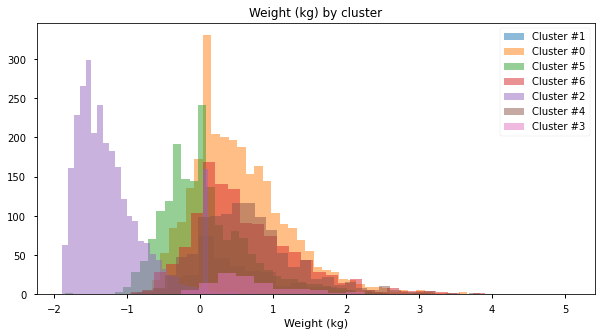

In [69]:
plot_clusters()

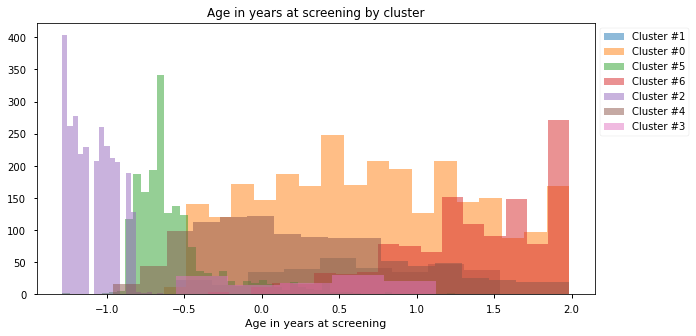

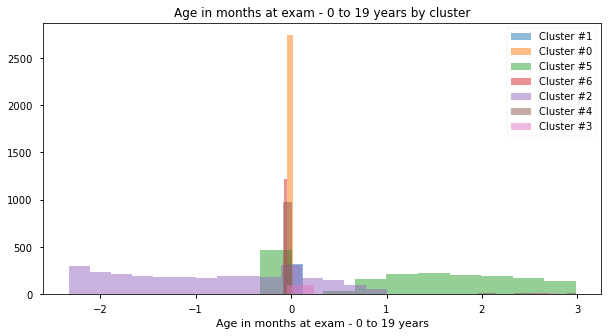

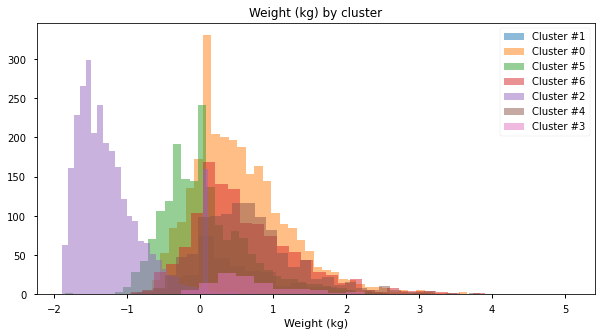

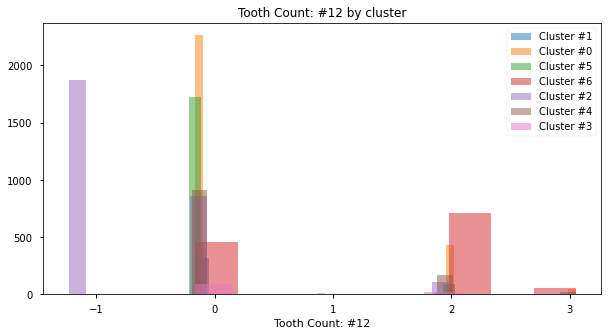

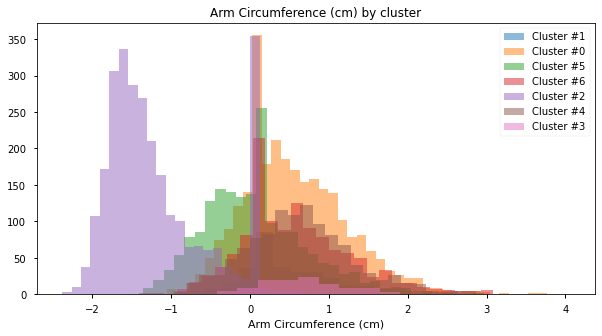

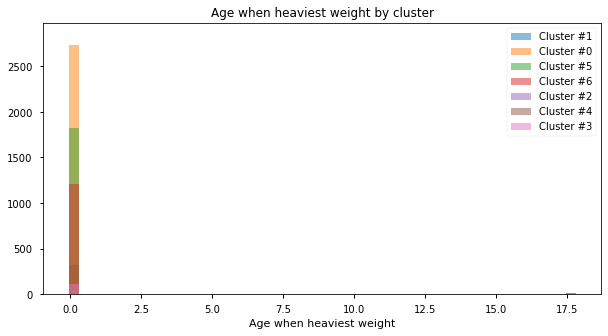

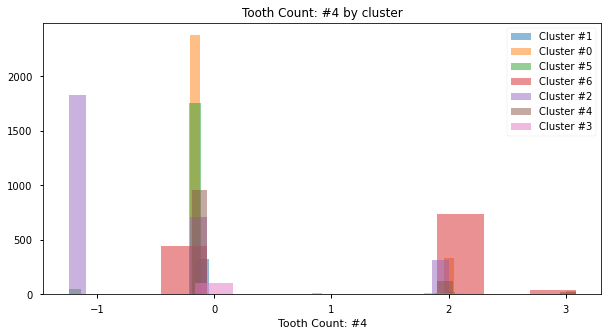

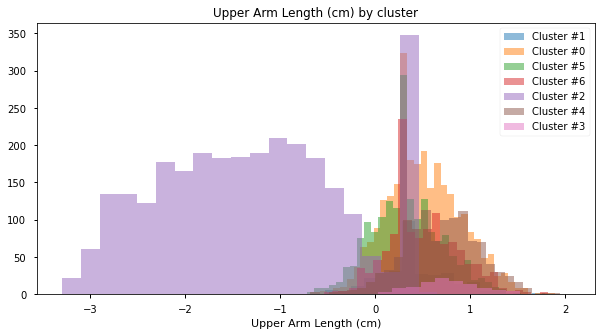

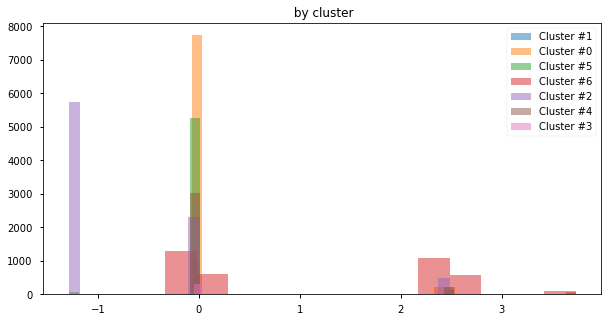

In [70]:
for feature in top_20:
    try:
        plot_clusters(col=feature)
    except:
        print(f'ERROR WITH {feature}')

### Student Capstone Project Using This Approach
https://github.com/Dantarshi/projectcapstone

# APPENDIX: Hierarchical Clustering

In [71]:
best_k

7

In [73]:
X_train

,WTDRD1,WTDR2D,DR1DRSTZ,DR1EXMER,DRABF,DRDINT,DR1DBIH,DR1DAY,DR1LANG,DR1MNRSP,DR1HELPD,DBQ095Z,DBD100,DRQSPREP,DR1STY,DR1SKY,DRQSDIET,DRQSDT1,DRQSDT2,DRQSDT3,DRQSDT7,DR1TNUMF,DR1TKCAL,DR1TPROT,DR1TCARB,DR1TSUGR,DR1TFIBE,DR1TTFAT,DR1TSFAT,DR1TMFAT,DR1TPFAT,DR1TCHOL,DR1TATOC,DR1TATOA,DR1TRET,DR1TVARA,DR1TACAR,DR1TBCAR,DR1TCRYP,DR1TLYCO,...,RHQ542B,RHQ542D,RHQ576Q,RHQ576U,RHQ580,RHQ586Q,RHQ586U,RHQ596,RHQ602Q,RHQ602U,RXQ525Q,RXQ525U,SMD630,SMQ661,SMQ665A,SMQ665B,SMQ665C,SMQ665D,SMQ690B,SMQ740,SMQ690G,SMQ845,SMQ690D,SMQ800,SMQ690E,SMQ817,SMQ690I,SMQ857,SMQ690J,SMQ861,SMQ690F,SMQ830,SMQ840,SXQ550,SXQ841,WHD080I,WHD080K,WHD080P,WHD080U,WHD080L
SEQN,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
80174,-0.881186,-0.323574,0.439071,-1.017933,0.115522,0.345844,-1.479190,-0.279713,1.665058,-0.221771,0.355429,8.857036,-0.513361,5.313841,10.814894,-0.043233,12.533906,0.0,0.0,0.0,0.0,-0.026751,-0.158241,-0.173263,-0.143304,-0.190643,-0.196104,-0.177927,-0.203631,-0.191532,-0.214333,-0.270032,-0.206766,-0.222951,-0.192399,-0.197070,-0.267687,-0.294539,-0.158285,-0.345981,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
82577,3.003902,-0.699846,-0.366909,0.234545,0.115522,-2.891475,1.726353,-0.279713,-0.260165,-0.221771,0.355429,0.071601,-0.513361,-1.958295,0.151806,-0.043233,-1.648978,0.0,0.0,0.0,0.0,-0.026751,-0.298791,1.531972,-0.647347,-0.761226,-0.067239,-0.767043,-1.001302,-0.628222,-0.564811,0.124612,-0.277209,-0.222951,-0.068503,-0.331438,-0.303222,-0.373091,0.051775,-0.536466,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
81692,-0.626748,-0.550456,-0.366909,0.860784,0.115522,0.345844,-1.387603,1.193414,-0.260165,-0.221771,0.355429,-0.205833,-0.513361,-0.140261,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-0.946937,-0.660682,-0.827062,-0.577703,-0.615798,0.179753,-0.416971,-0.017278,-0.828169,-0.566197,-0.794675,-0.490073,-0.202423,0.353869,-0.026057,-0.300086,-0.376700,0.029496,-0.045940,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
76443,-0.881186,-0.323574,2.857014,0.234545,0.115522,0.345844,-0.013799,0.211329,-0.260165,-0.221771,0.355429,-0.205833,-0.513361,-0.140261,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-0.026751,-0.158241,-0.173263,-0.143304,-0.190643,-0.196104,-0.177927,-0.203631,-0.191532,-0.214333,-0.270032,-0.206766,-0.222951,-0.192399,-0.197070,-0.267687,-0.294539,-0.158285,-0.345981,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
76258,-0.077228,-0.229587,-0.366909,2.426382,0.115522,0.345844,0.444136,-0.279713,-0.260165,-0.221771,-2.561739,0.071601,-0.513361,0.768756,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-0.394825,0.305466,0.037609,0.694539,-0.139743,2.101991,0.031446,0.348992,-0.136695,-0.182384,-0.585746,0.111763,-0.222951,1.009955,0.513450,-0.241558,-0.276774,-0.094631,0.708153,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79541,0.053999,-0.147825,-0.366909,2.426382,0.115522,0.345844,-0.380147,0.702372,-0.260165,-0.221771,-1.235754,-0.205833,0.968468,0.768756,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,-1.130974,-0.440449,0.197589,-0.493725,-0.702461,-0.926340,-0.437310,-0.851109,-

In [79]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage


In [80]:
agglom = AgglomerativeClustering(n_clusters=best_k)
agglom.fit(df_pca)

AgglomerativeClustering(n_clusters=7)

In [81]:
h_clusters = agglom.fit_predict(df_pca)
h_clusters

array([0, 5, 1, ..., 0, 2, 2])

### Visuaalizing Hierarchical Clusters 
https://stackabuse.com/hierarchical-clustering-with-python-and-scikit-learn/

In [84]:
linked = linkage(df_pca, 'single')
linked

array([[4.86900000e+03, 5.85700000e+03, 5.20473470e-02, 2.00000000e+00],
       [6.86900000e+03, 9.42400000e+03, 6.26709644e-02, 2.00000000e+00],
       [7.37800000e+03, 1.00150000e+04, 6.69842954e-02, 2.00000000e+00],
       ...,
       [2.03430000e+04, 2.03440000e+04, 2.96508927e+01, 1.00640000e+04],
       [2.03420000e+04, 2.03450000e+04, 3.49960182e+01, 1.11000000e+02],
       [2.03460000e+04, 2.03470000e+04, 4.78955607e+01, 1.01750000e+04]])

In [87]:
# import sys
# sys.setrecursionlimit(10000)

# plt.figure(figsize=(10, 7))
# dendrogram(linked,
#             orientation='top',
# #             labels=h_clusters,
#             distance_sort='descending',
#             show_leaf_counts=True)
# plt.show()